In [1]:
# -*- coding: utf-8 -*-

# Import libraries: NumPy, pandas, matplotlib
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
matplotlib.style.use('ggplot')

from __future__ import unicode_literals

# Tell iPython to include plots inline in the notebook
%matplotlib inline

# # Read dataset
# data = pd.read_csv("log_book/0.csv")
# print "Dataset has {} rows, {} columns".format(*data.shape)
# print data.head()  # print the first 5 rows

In [2]:
# Read log book index
indices = pd.read_csv("log_index.csv")
print "Dataset has {} rows, {} columns".format(*indices.shape)
print indices.head()

Dataset has 125 rows, 4 columns
  filename  alpha  gamma  sigma
0    0.csv   0.01   0.01   0.01
1    1.csv   0.01   0.01   0.10
2    2.csv   0.01   0.01   0.50
3    3.csv   0.01   0.01   0.80
4    4.csv   0.01   0.01   1.00


In [3]:
def show_graph(filename, alpha=0.0, gamma=0.0, sigma=0.0):
    log_folder = "log_book/"
    data = pd.read_csv(log_folder + filename)
    
    data['norm_rewards'] = data['rewards'] / data['distance']
    data['avg_rewards'] = data['rewards'] / data['steps']
    data['time'] = data['steps'] / data['deadline']
    data['optimum_time'] = data['distance'] / data['deadline']
    data['penalties'] = np.absolute(data['penalties'])

    title = "file: {}, alpha: {}, gamma: {}, sigma: {}".format(filename, alpha, gamma, sigma)
    viz = data[['time', 'norm_rewards', 'avg_rewards', 'penalties']]
    viz.plot(subplots=True, layout=(-1,4), figsize=(20,3), title=title)

# show_graph("0.csv")

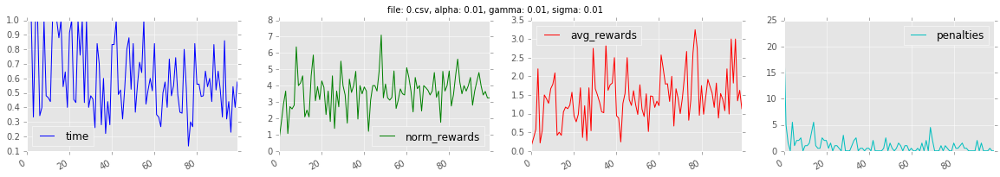

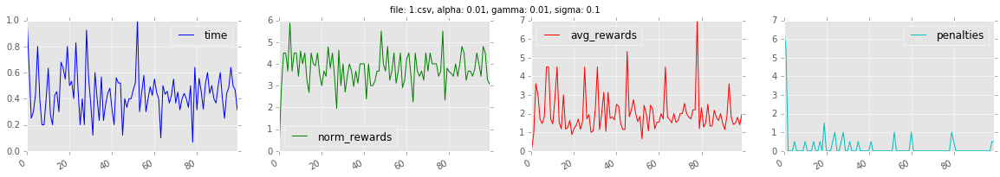

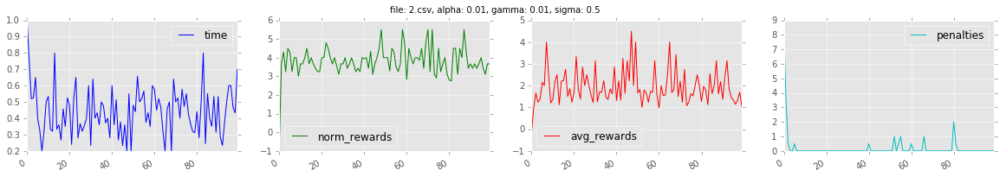

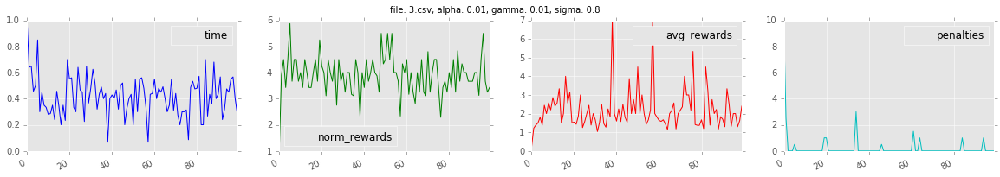

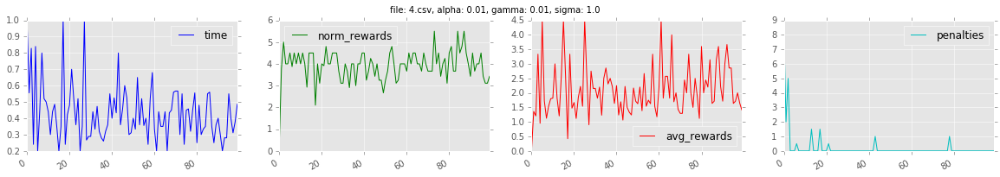

...

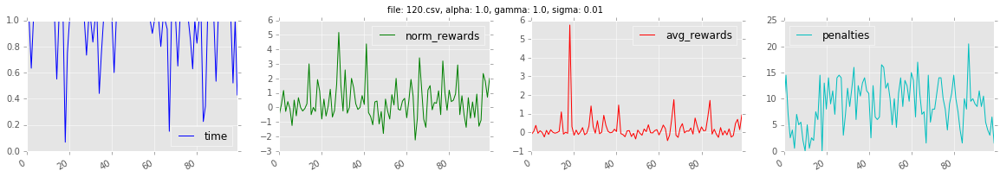

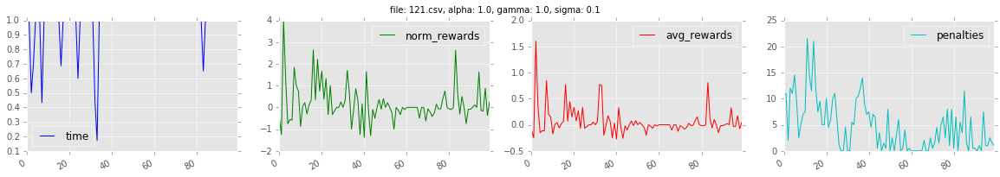

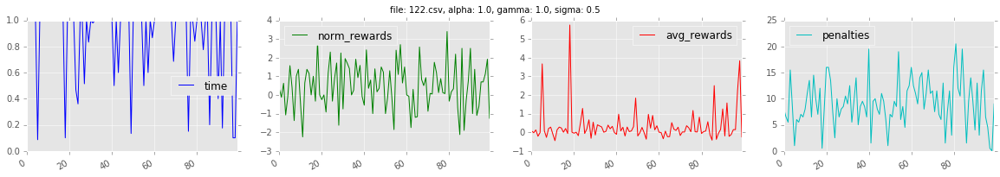

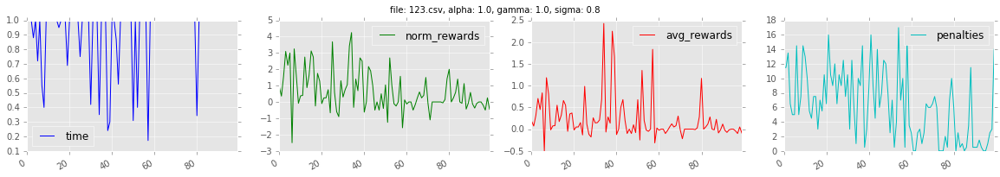

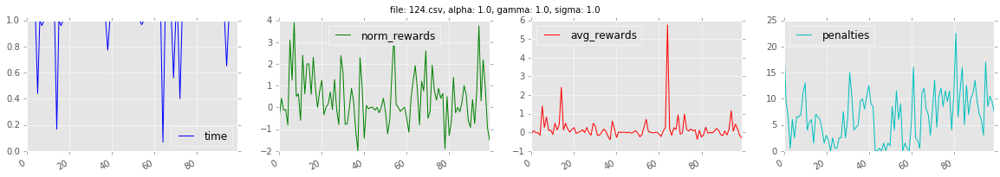

In [59]:
for i, r in indices.iterrows():
    show_graph(*tuple(r[r.index]))

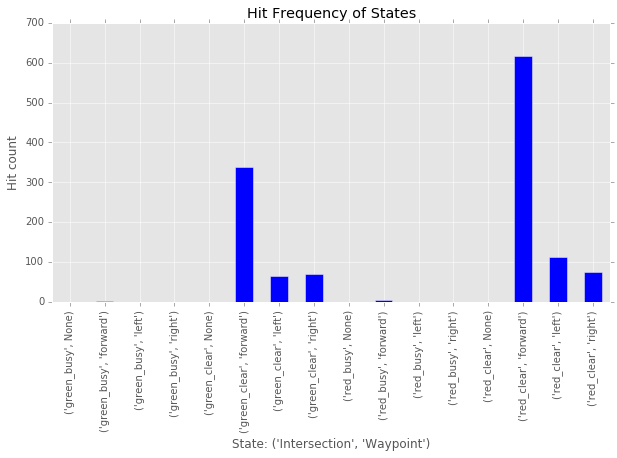

In [90]:
def show_state_hit(filename):
    q_folder = "q_log/"
    data = pd.read_csv(q_folder + filename, header=0, index_col=0)
    data.index.name = "State: " + data.index.name
    ag = data['Hit(s)'].plot.bar(figsize=(10, 5), title="Hit Frequency of States")
    ag.set_ylabel("Hit count")

show_state_hit("11.csv")

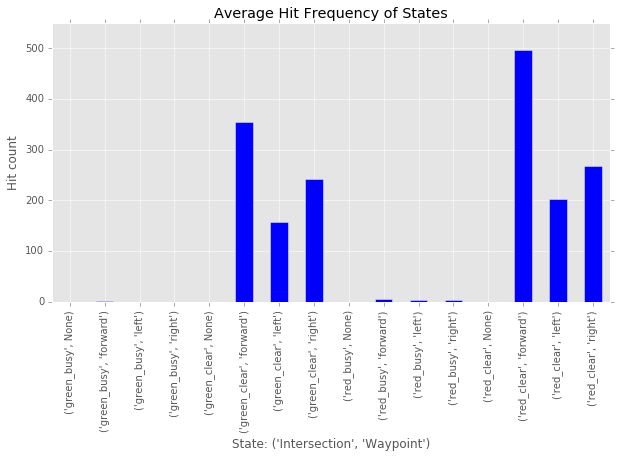

In [132]:
def get_hits(filename):
    q_folder = "q_log/"
    data = pd.read_csv(q_folder + filename, header=0, index_col=0)
    return data['Hit(s)']

#     d2 = pd.DataFrame(index=data.index)
# #     d2.index = data.index
#     d2['Hits'] =  np.zeros(len(d2.index))
#     d2['Hits'] += data['Hit(s)']
#     print d2

def show_average_hits():
    temp = get_hits("0.csv")
    hits = pd.DataFrame(index=temp.index)
    hits['Hits'] = np.zeros(len(hits.index))

    count = 0
    for i, r in indices.iterrows():
        hit = get_hits(r['filename'])
        hits['Hits'] += hit
        count += 1

    hits['Hits'] /= count

    hits.index.name = "State: " + hits.index.name
    ag = hits['Hits'].plot.bar(figsize=(10, 5),
                               ylim=(0, 550),
                               title="Average Hit Frequency of States")
    ag.set_ylabel("Hit count")

show_average_hits()


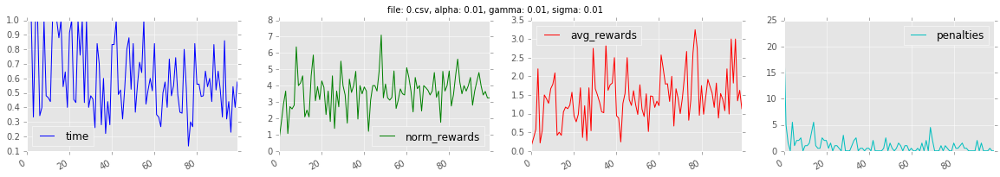

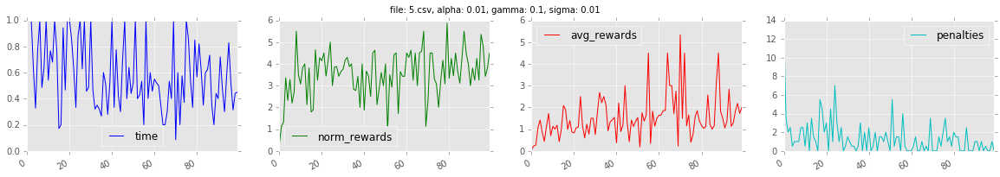

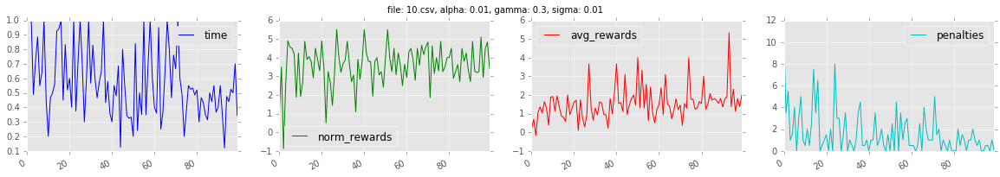

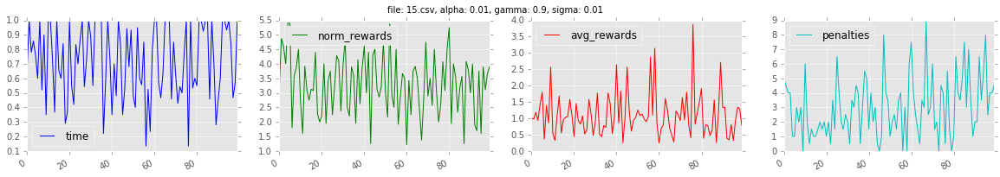

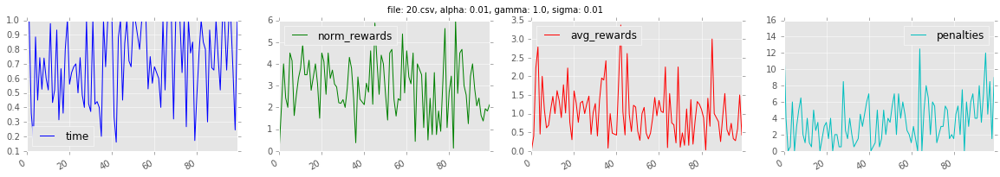

...

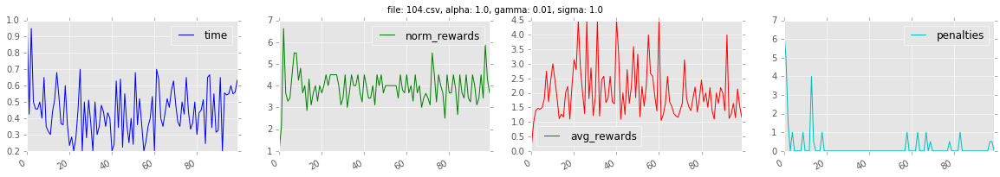

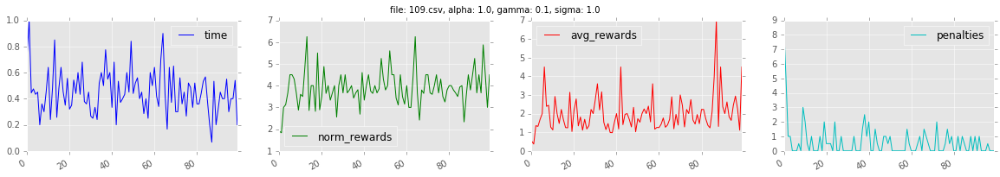

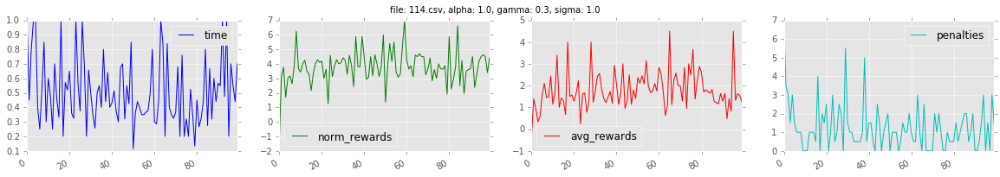

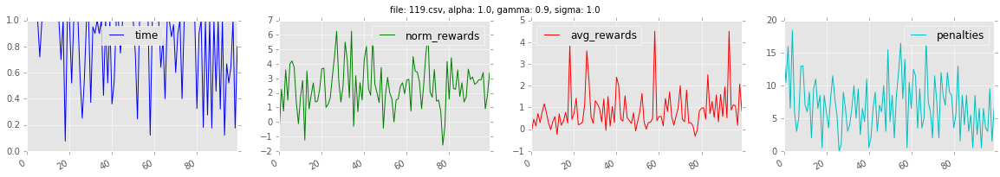

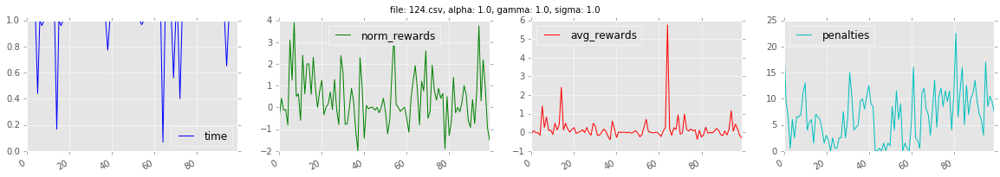

In [139]:
gamma_i = indices.sort_values(['alpha', 'sigma', 'gamma'])
for i, r in gamma_i.iterrows():
    show_graph(*tuple(r[r.index]))

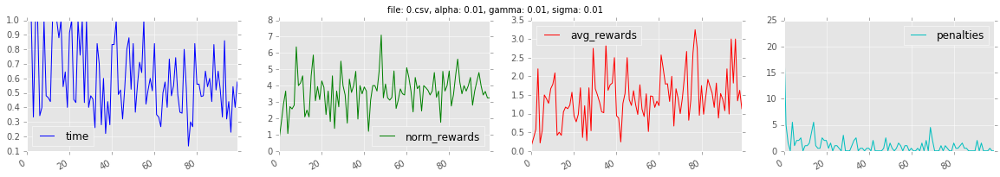

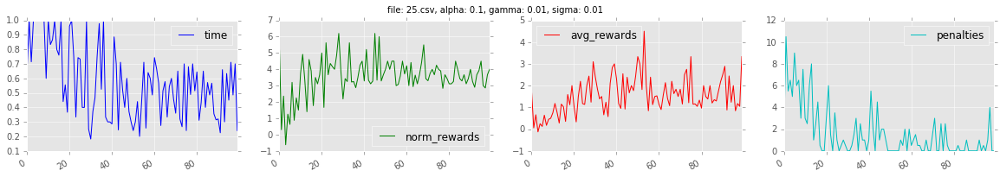

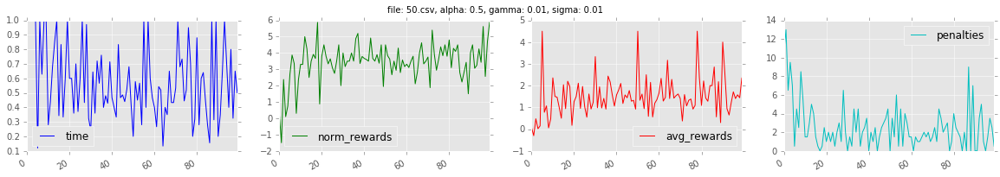

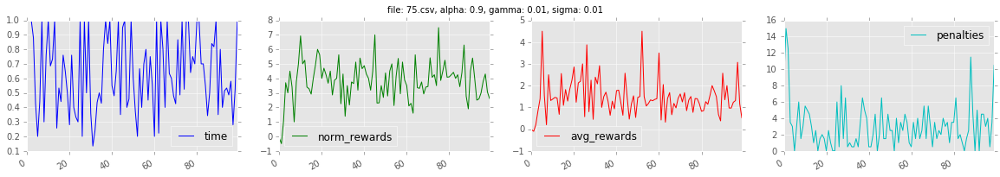

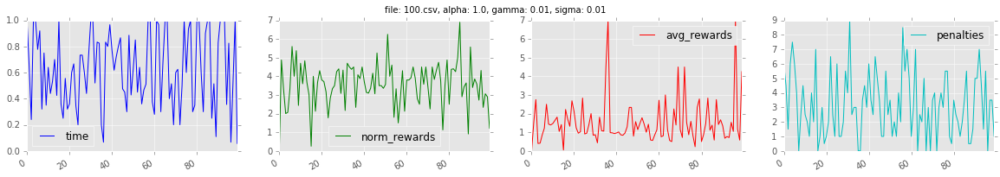

...

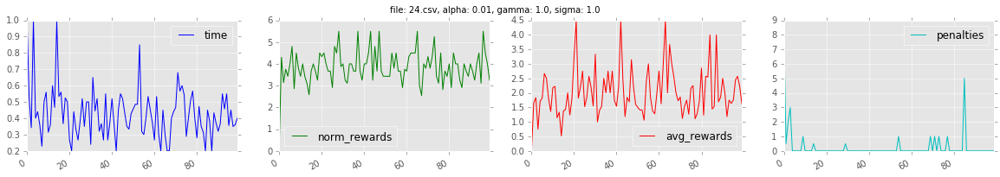

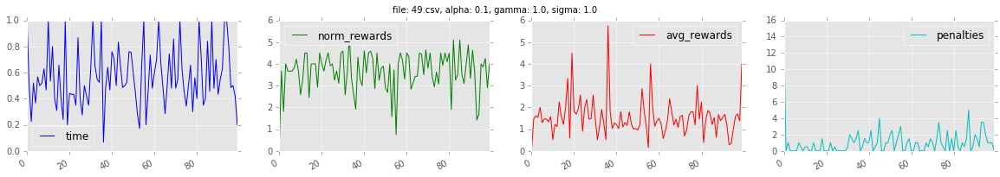

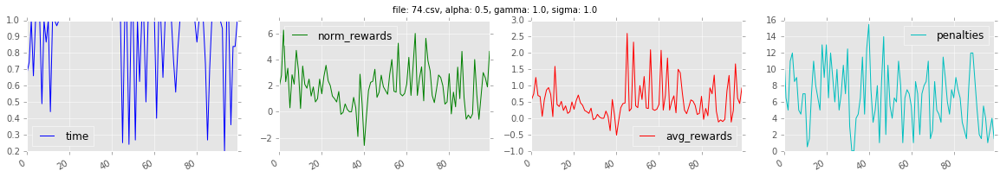

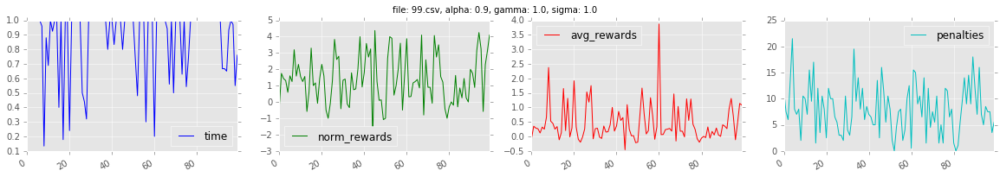

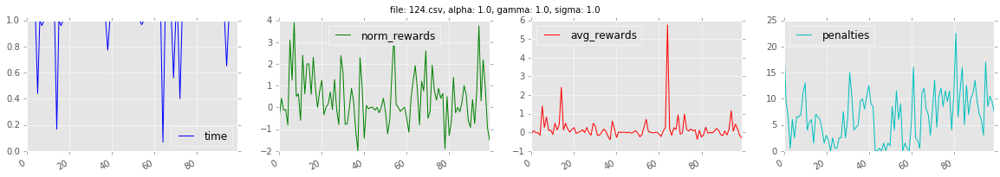

In [144]:
alpha_i = indices.sort_values(['sigma', 'gamma', 'alpha'])
for i, r in alpha_i.iterrows():
    show_graph(*tuple(r[r.index]))

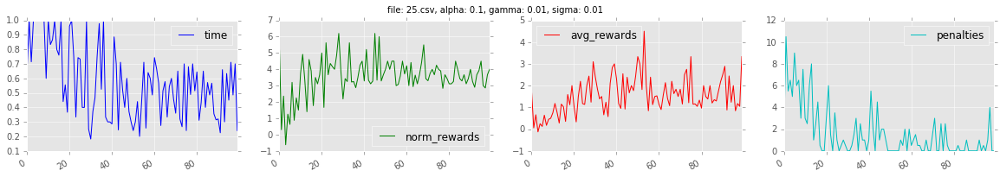

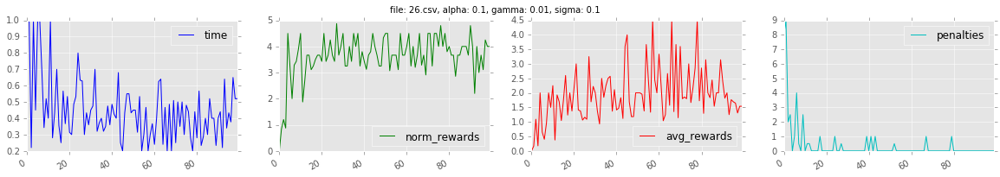

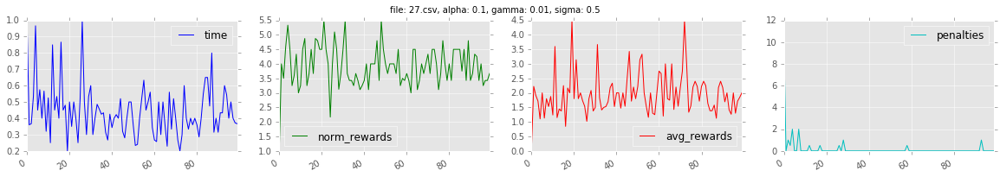

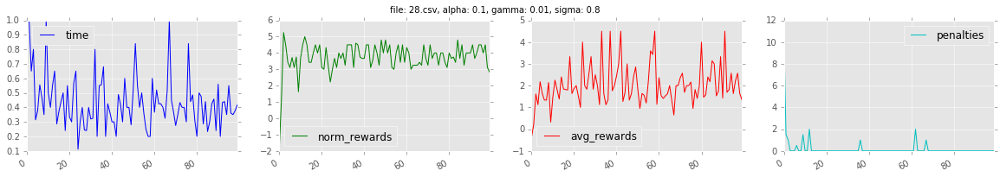

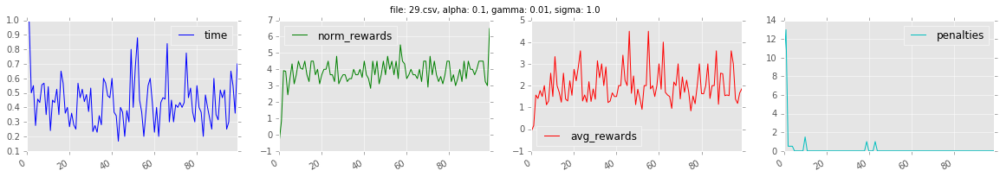

In [31]:
for i, r in indices.iloc[range(25,30)].iterrows():
    show_graph(*tuple(r[r.index]))

In [4]:
def get_column(filename, column):
    log_folder = "log_book/"
    data = pd.read_csv(log_folder + filename, header=0)
    data['time'] = data['steps'] / data['deadline']
    data['rewards'] = data['rewards'] / data['distance']
    return data[column]

def new_df():
    temp = get_column("0.csv", 'rewards')
    return pd.DataFrame(index=temp.index)

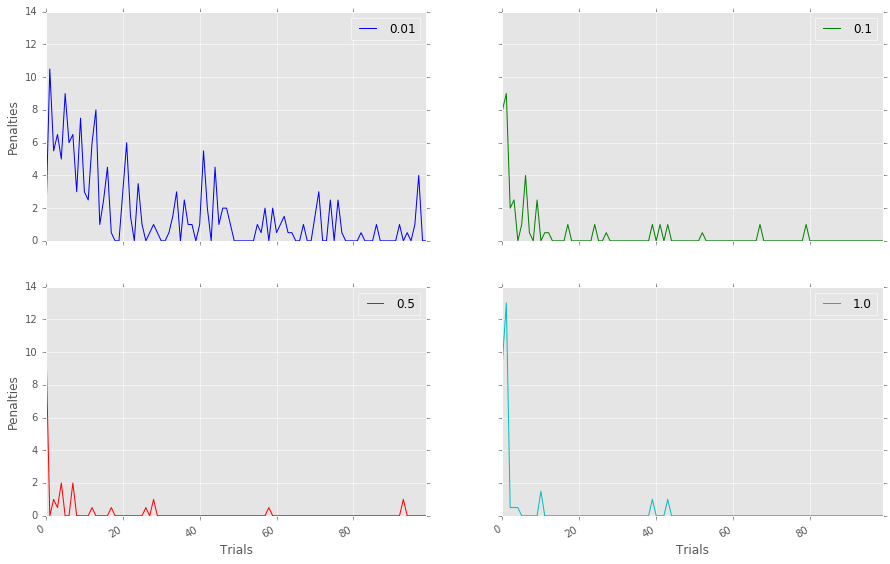

In [92]:
def graph_sigma():
    df = new_df()
    for i, r in indices.iloc[[25, 26, 27, 29]].iterrows():
        df[str(r['sigma'])] = get_column(r['filename'], 'penalties').abs()
    
    ag = df.plot(figsize=(15,10),
            subplots=True, layout=(-1,2), sharey=True)
    
    for a in ag:
        for b in a:
            b.set_ylabel("Penalties")
            b.set_xlabel("Trials")

#         show_graph(*tuple(r[r.index]))

graph_sigma()

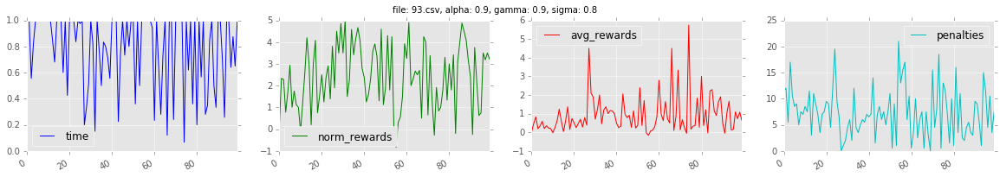

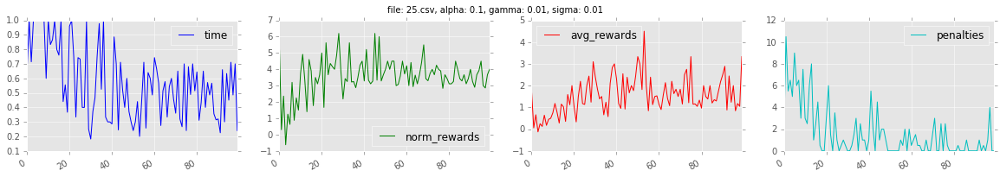

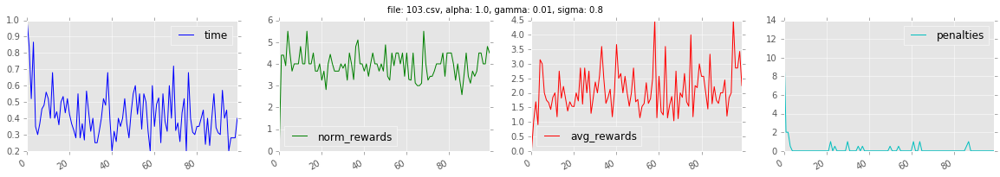

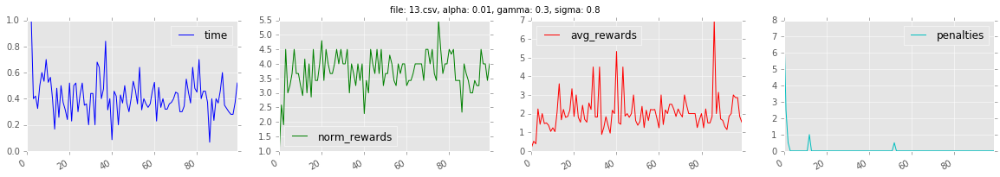

In [96]:
def graph_candidates():
#     df = new_df()
    for i, r in indices.iloc[[93, 25, 103, 13]].iterrows():
#         df[str(r['sigma'])] = get_column(r['filename'], 'penalties').abs()
        show_graph(*tuple(r[r.index]))

graph_candidates()

In [5]:
MODELS = [93, 25, 13]

In [41]:
def graph_col(title, col_getter, ylim=None):
    df = new_df()
    df.index.name = "Trials"
    labels = []
    for i, r in indices.iloc[MODELS].iterrows():
        legend = r"$\alpha = {}, \gamma = {},  \sigma = {}$".format(*tuple(r[r.index][1:]))
        labels.append(legend)
        df[legend] = col_getter(r['filename'])
    ag = df.plot(figsize=(15,4), layout=(-1,3), legend=False,
            subplots=True, sharey=True, sharex=True, colormap="flag",
            ylim=ylim)

    plt.tight_layout(pad=2.0, w_pad=1.5, h_pad=1.0)
    for label, ax in zip(labels, ag[0]):
        ax.set_title(label)
        ax.set_ylabel(title)
        
# graph_penalties()

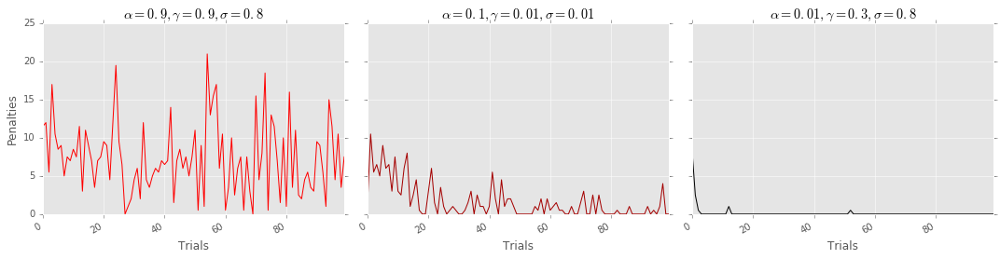

In [42]:
graph_col("Penalties", lambda f: get_column(f, 'penalties').abs())

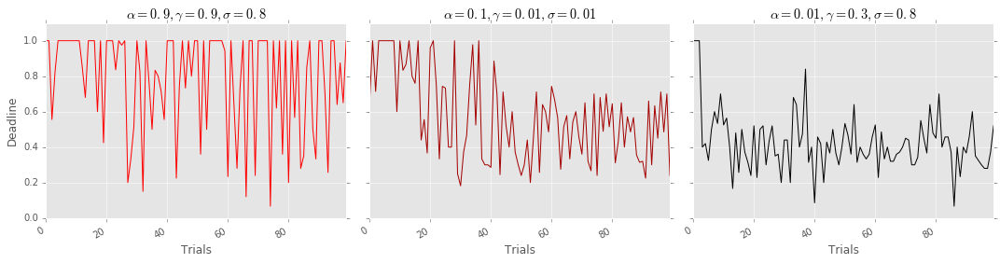

In [45]:
graph_col("Deadline", lambda f: get_column(f, 'time'), ylim=(0.0, 1.1))

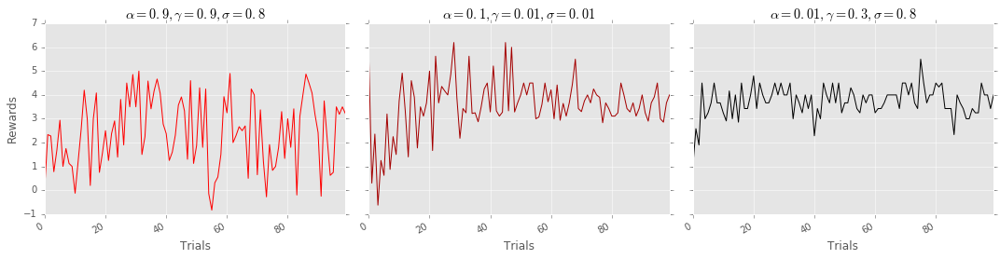

In [44]:
graph_col("Rewards", lambda f: get_column(f, 'rewards'))